## **Setup and Imports**

In [1]:
!pip install diffusers -q

In [2]:
import torch
from torchvision import transforms
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.optim import AdamW
from diffusers import UNet2DModel, DDPMScheduler, DDPMPipeline
from diffusers.optimization import get_cosine_schedule_with_warmup
from datasets import Dataset
from accelerate import Accelerator
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np
import random 
import timeit
import os
import csv
import shutil

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

## **Configuration and Random Seed Initialization**

In [3]:
RANDOM_SEED = 42
IMG_SIZE = 128  
BATCH_SIZE = 16 
LEARNING_RATE = 1e-4  
NUM_EPOCHS = 800  
LOG_INTERVAL = 10
NUM_GENERATE_IMAGES = 6  
NUM_TIMESTEPS = 1000             # Number of timesteps
MIXED_PRECISION = "fp16"         # Use mixed precision (fp16) for faster computation
GRADIENT_ACCUMULATION_STEPS = 1  # Steps for accumulating gradients

random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)
torch.cuda.manual_seed(RANDOM_SEED)
torch.cuda.manual_seed_all(RANDOM_SEED)
torch.backends.cudnn.deterministic = True  # Ensures reproducibility
torch.backends.cudnn.benchmark = False     # Disables optimizations for non-deterministic behavior

device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## **Data Loading and Preprocessing**

In [4]:
# Define the path to the image directory for training data
image_directory = '/kaggle/input/oasis-2/views/sagittal/moderate_dementia'

In [5]:
data = []

# Load images from the directory into a list
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  
        image_path = os.path.join(image_directory, filename)    
        with Image.open(image_path) as img:
            img_gray = img.convert('L')  
            image_entry = {
                'image': img_gray, 
                'name': filename
            }
            data.append(image_entry)

# Create a dataset from the loaded images
dataset = Dataset.from_dict({
    'image': [entry['image'] for entry in data],
    'name': [entry['name'] for entry in data]
})
dataset

Dataset({
    features: ['image', 'name'],
    num_rows: 475
})

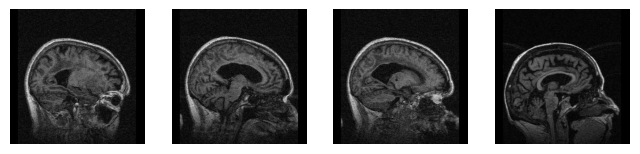

In [6]:
# Display a few images from the dataset to visualize the data
fig, axs = plt.subplots(1, 4, figsize=(8, 4))
for i, image in enumerate(dataset[:4]["image"]):
    axs[i].imshow(image, cmap='gray')  
    axs[i].set_axis_off()
fig.show()

In [7]:
# Define preprocessing steps (resize, normalize, etc.)
preprocess = transforms.Compose(
[
    transforms.Resize((IMG_SIZE, IMG_SIZE)),                     
    transforms.ToTensor(),                                       
    transforms.Normalize([0.5], [0.5])                           
])

# Function to apply preprocessing transformation to the dataset
def transform(examples):
    images = [preprocess(image.convert("L")) for image in examples["image"]]  
    return {"images": images}
    
# Apply the transformation to the dataset
dataset.set_transform(transform)

# Prepare data loader for batching
train_dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=False)

## **Model Initialization** 

In [8]:
# Define the UNet model for diffusion-based image generation
model = UNet2DModel(
    sample_size=IMG_SIZE,                               # Image size input to the model
    in_channels=1,                                      # Number of input channels (1 for grayscale)
    out_channels=1,                                     # Number of output channels (1 for grayscale)
    layers_per_block=2,                                 # Number of layers per block
    block_out_channels=(128, 128, 256, 256, 512, 512),  # Output channels at each block
    down_block_types=(
        "DownBlock2D", 
        "DownBlock2D", 
        "DownBlock2D", 
        "DownBlock2D", 
        "AttnDownBlock2D", 
        "DownBlock2D"
    ),
    up_block_types=(
        "UpBlock2D", 
        "AttnUpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D", 
        "UpBlock2D"
    )
)

# Move the model to the appropriate device (CUDA or CPU)
model = model.to(device)

In [9]:
# Sample a single image to check input-output shapes
sample_image = dataset[0]["images"].unsqueeze(0).to(device)
print("Input shape:", sample_image.shape)
print("Output shape:", model(sample_image, timestep=0).sample.shape)

Input shape: torch.Size([1, 1, 128, 128])
Output shape: torch.Size([1, 1, 128, 128])


## **Image Generation Function**

In [10]:
# Function to generate and visualize sample images from the trained model
def generate(model, noise_scheduler, num_generate_images, random_seed, num_timesteps, save_path):

    # Ensure save path exists
    os.makedirs(save_path, exist_ok=True)
    
    # Create the pipeline
    pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)
    
    # Generate images using the pipeline
    images = pipeline(
        batch_size=num_generate_images,
        generator=torch.manual_seed(random_seed),
        num_inference_steps=num_timesteps
    ).images
    
    # Visualize and save generated images in a single row
    fig = plt.figure(figsize=(num_generate_images * 3, 3)) 
    
    for i in range(1, num_generate_images + 1):
        ax = fig.add_subplot(1, num_generate_images, i)  
        ax.imshow(images[i-1], cmap='gray')
        ax.axis('off')  
        
        # Save the image to the specified path
        image_name = f"generated_image_{i}.png"
        image_path = os.path.join(save_path, image_name)
        images[i-1].save(image_path)

    # Show the plot
    plt.show()

## **Noise Scheduler, Optimizer and Learning Rate**

In [11]:
# Initialize noise scheduler for diffusion process
noise_scheduler = DDPMScheduler(num_train_timesteps=NUM_TIMESTEPS)

# Initialize optimizer and learning rate scheduler
optimizer = AdamW(
    model.parameters(), 
    lr=LEARNING_RATE
)

lr_scheduler = get_cosine_schedule_with_warmup(
    optimizer=optimizer,
    num_warmup_steps=500,
    num_training_steps=len(train_dataloader)*NUM_EPOCHS
)

## **Accelerator Setup**

In [12]:
# Initialize accelerator for mixed precision and gradient accumulation
accelerator = Accelerator(
    mixed_precision=MIXED_PRECISION,
    gradient_accumulation_steps=GRADIENT_ACCUMULATION_STEPS
)

# Prepare model, optimizer, data loader, and learning rate scheduler with accelerator
model, optimizer, train_dataloader, lr_scheduler = accelerator.prepare(
    model, 
    optimizer, 
    train_dataloader, 
    lr_scheduler
)

/opt/conda/lib/python3.10/site-packages/accelerate/accelerator.py:494: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(**kwargs)


## **Training Loop**

Epoch: 1 | Loss: 0.8924
Epoch: 2 | Loss: 0.2264
Epoch: 3 | Loss: 0.0600
Epoch: 4 | Loss: 0.0573
Epoch: 5 | Loss: 0.0387
Epoch: 6 | Loss: 0.0357
Epoch: 7 | Loss: 0.0297
Epoch: 8 | Loss: 0.0353
Epoch: 9 | Loss: 0.0257
Epoch: 10 | Loss: 0.0299


  0%|          | 0/1000 [00:00<?, ?it/s]

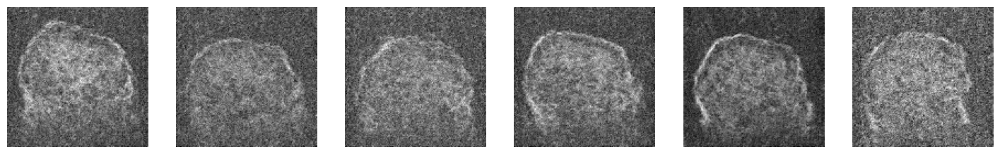

Epoch: 11 | Loss: 0.0284
Epoch: 12 | Loss: 0.0292
Epoch: 13 | Loss: 0.0217
Epoch: 14 | Loss: 0.0272
Epoch: 15 | Loss: 0.0242
Epoch: 16 | Loss: 0.0243
Epoch: 17 | Loss: 0.0170
Epoch: 18 | Loss: 0.0206
Epoch: 19 | Loss: 0.0215
Epoch: 20 | Loss: 0.0206


  0%|          | 0/1000 [00:00<?, ?it/s]

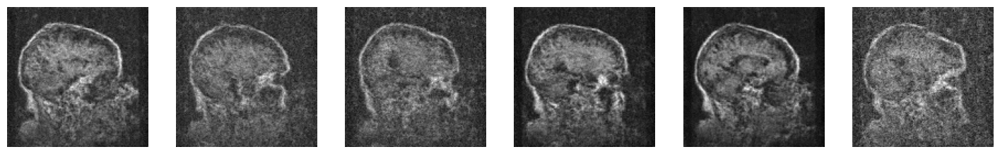

Epoch: 21 | Loss: 0.0231
Epoch: 22 | Loss: 0.0251
Epoch: 23 | Loss: 0.0182
Epoch: 24 | Loss: 0.0213
Epoch: 25 | Loss: 0.0194
Epoch: 26 | Loss: 0.0183
Epoch: 27 | Loss: 0.0139
Epoch: 28 | Loss: 0.0174
Epoch: 29 | Loss: 0.0187
Epoch: 30 | Loss: 0.0183


  0%|          | 0/1000 [00:00<?, ?it/s]

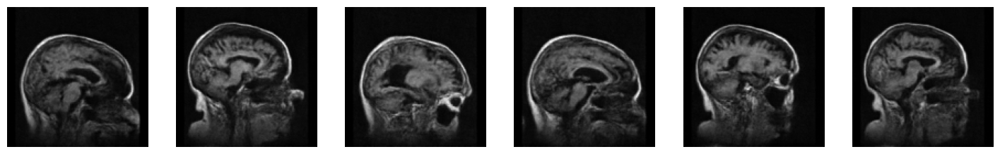

Epoch: 31 | Loss: 0.0203
Epoch: 32 | Loss: 0.0228
Epoch: 33 | Loss: 0.0162
Epoch: 34 | Loss: 0.0194
Epoch: 35 | Loss: 0.0170
Epoch: 36 | Loss: 0.0166
Epoch: 37 | Loss: 0.0124
Epoch: 38 | Loss: 0.0159
Epoch: 39 | Loss: 0.0173
Epoch: 40 | Loss: 0.0168


  0%|          | 0/1000 [00:00<?, ?it/s]

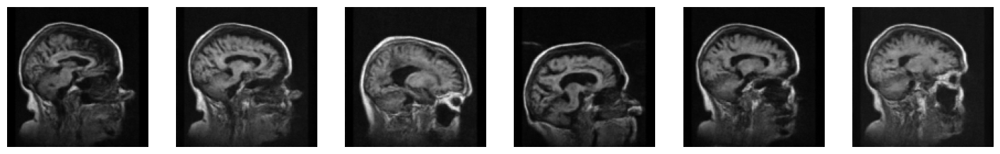

Epoch: 41 | Loss: 0.0189
Epoch: 42 | Loss: 0.0208
Epoch: 43 | Loss: 0.0145
Epoch: 44 | Loss: 0.0176
Epoch: 45 | Loss: 0.0158
Epoch: 46 | Loss: 0.0154
Epoch: 47 | Loss: 0.0115
Epoch: 48 | Loss: 0.0149
Epoch: 49 | Loss: 0.0162
Epoch: 50 | Loss: 0.0156


  0%|          | 0/1000 [00:00<?, ?it/s]

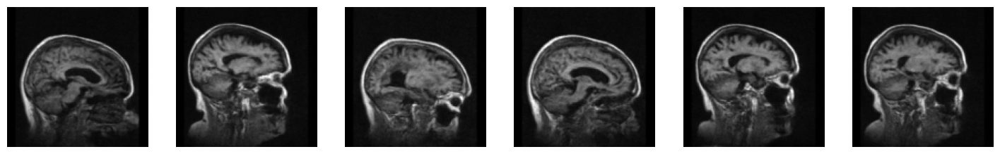

Epoch: 51 | Loss: 0.0175
Epoch: 52 | Loss: 0.0196
Epoch: 53 | Loss: 0.0135
Epoch: 54 | Loss: 0.0166
Epoch: 55 | Loss: 0.0147
Epoch: 56 | Loss: 0.0143
Epoch: 57 | Loss: 0.0107
Epoch: 58 | Loss: 0.0137
Epoch: 59 | Loss: 0.0153
Epoch: 60 | Loss: 0.0146


  0%|          | 0/1000 [00:00<?, ?it/s]

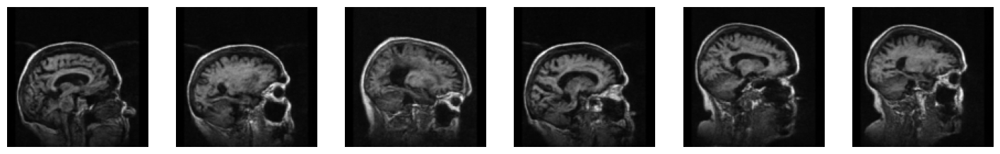

Epoch: 61 | Loss: 0.0165
Epoch: 62 | Loss: 0.0184
Epoch: 63 | Loss: 0.0126
Epoch: 64 | Loss: 0.0156
Epoch: 65 | Loss: 0.0139
Epoch: 66 | Loss: 0.0133
Epoch: 67 | Loss: 0.0099
Epoch: 68 | Loss: 0.0128
Epoch: 69 | Loss: 0.0143
Epoch: 70 | Loss: 0.0141


  0%|          | 0/1000 [00:00<?, ?it/s]

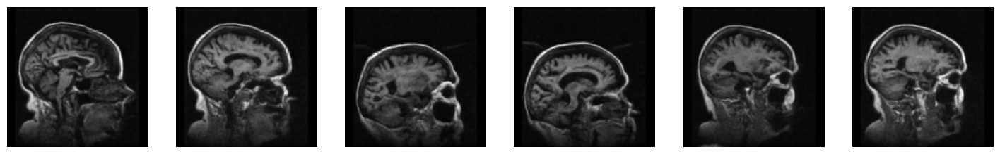

Epoch: 71 | Loss: 0.0157
Epoch: 72 | Loss: 0.0178
Epoch: 73 | Loss: 0.0118
Epoch: 74 | Loss: 0.0145
Epoch: 75 | Loss: 0.0136
Epoch: 76 | Loss: 0.0127
Epoch: 77 | Loss: 0.0095
Epoch: 78 | Loss: 0.0122
Epoch: 79 | Loss: 0.0138
Epoch: 80 | Loss: 0.0135


  0%|          | 0/1000 [00:00<?, ?it/s]

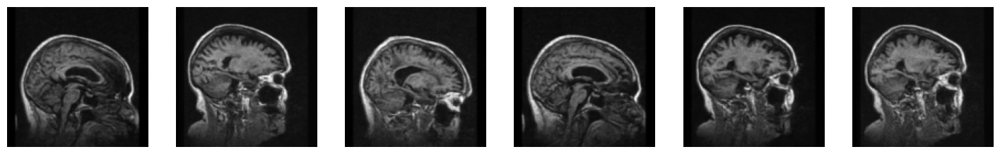

Epoch: 81 | Loss: 0.0152
Epoch: 82 | Loss: 0.0170
Epoch: 83 | Loss: 0.0109
Epoch: 84 | Loss: 0.0136
Epoch: 85 | Loss: 0.0128
Epoch: 86 | Loss: 0.0119
Epoch: 87 | Loss: 0.0088
Epoch: 88 | Loss: 0.0113
Epoch: 89 | Loss: 0.0128
Epoch: 90 | Loss: 0.0127


  0%|          | 0/1000 [00:00<?, ?it/s]

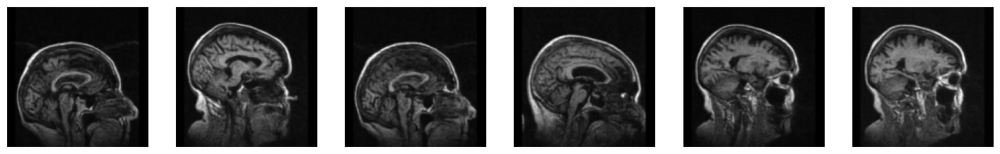

Epoch: 91 | Loss: 0.0144
Epoch: 92 | Loss: 0.0163
Epoch: 93 | Loss: 0.0104
Epoch: 94 | Loss: 0.0128
Epoch: 95 | Loss: 0.0120
Epoch: 96 | Loss: 0.0111
Epoch: 97 | Loss: 0.0083
Epoch: 98 | Loss: 0.0107
Epoch: 99 | Loss: 0.0124
Epoch: 100 | Loss: 0.0123


  0%|          | 0/1000 [00:00<?, ?it/s]

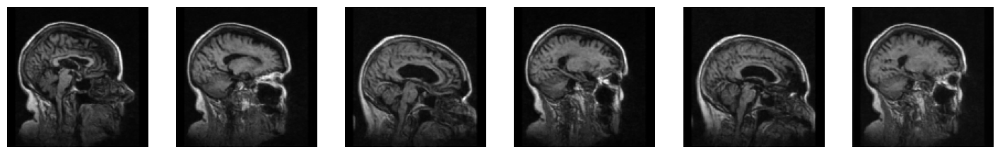

Epoch: 101 | Loss: 0.0137
Epoch: 102 | Loss: 0.0156
Epoch: 103 | Loss: 0.0100
Epoch: 104 | Loss: 0.0124
Epoch: 105 | Loss: 0.0115
Epoch: 106 | Loss: 0.0108
Epoch: 107 | Loss: 0.0079
Epoch: 108 | Loss: 0.0100
Epoch: 109 | Loss: 0.0116
Epoch: 110 | Loss: 0.0117


  0%|          | 0/1000 [00:00<?, ?it/s]

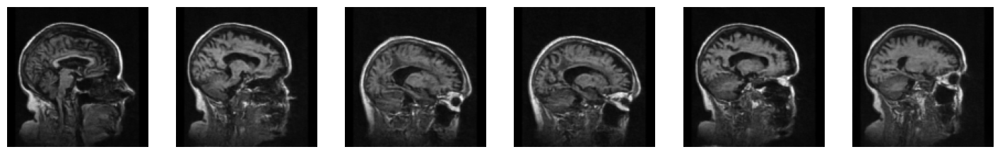

Epoch: 111 | Loss: 0.0128
Epoch: 112 | Loss: 0.0147
Epoch: 113 | Loss: 0.0096
Epoch: 114 | Loss: 0.0116
Epoch: 115 | Loss: 0.0110
Epoch: 116 | Loss: 0.0103
Epoch: 117 | Loss: 0.0077
Epoch: 118 | Loss: 0.0098
Epoch: 119 | Loss: 0.0111
Epoch: 120 | Loss: 0.0111


  0%|          | 0/1000 [00:00<?, ?it/s]

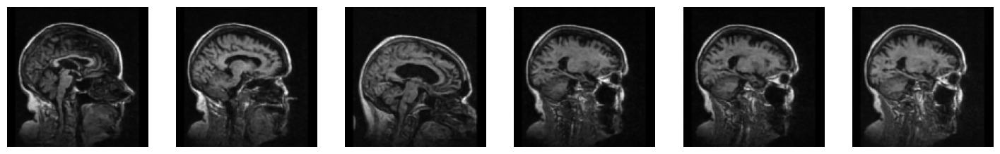

Epoch: 121 | Loss: 0.0124
Epoch: 122 | Loss: 0.0141
Epoch: 123 | Loss: 0.0093
Epoch: 124 | Loss: 0.0112
Epoch: 125 | Loss: 0.0106
Epoch: 126 | Loss: 0.0098
Epoch: 127 | Loss: 0.0073
Epoch: 128 | Loss: 0.0091
Epoch: 129 | Loss: 0.0103
Epoch: 130 | Loss: 0.0102


  0%|          | 0/1000 [00:00<?, ?it/s]

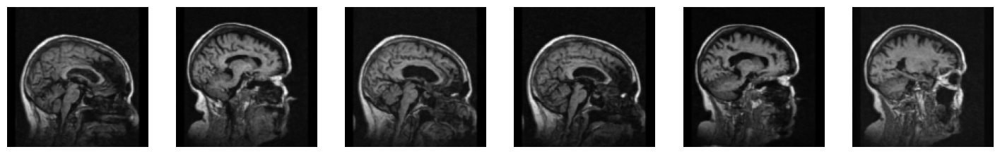

Epoch: 131 | Loss: 0.0117
Epoch: 132 | Loss: 0.0134
Epoch: 133 | Loss: 0.0086
Epoch: 134 | Loss: 0.0104
Epoch: 135 | Loss: 0.0096
Epoch: 136 | Loss: 0.0089
Epoch: 137 | Loss: 0.0065
Epoch: 138 | Loss: 0.0084
Epoch: 139 | Loss: 0.0096
Epoch: 140 | Loss: 0.0099


  0%|          | 0/1000 [00:00<?, ?it/s]

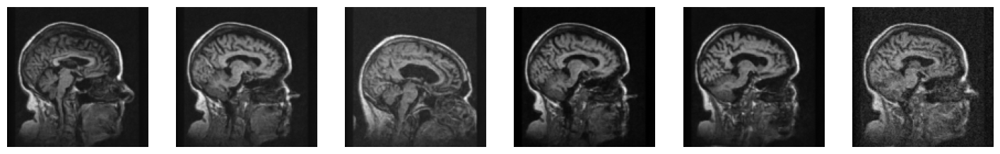

Epoch: 141 | Loss: 0.0113
Epoch: 142 | Loss: 0.0126
Epoch: 143 | Loss: 0.0081
Epoch: 144 | Loss: 0.0099
Epoch: 145 | Loss: 0.0099
Epoch: 146 | Loss: 0.0087
Epoch: 147 | Loss: 0.0066
Epoch: 148 | Loss: 0.0083
Epoch: 149 | Loss: 0.0094
Epoch: 150 | Loss: 0.0095


  0%|          | 0/1000 [00:00<?, ?it/s]

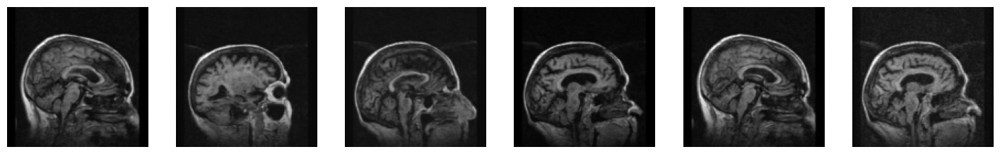

Epoch: 151 | Loss: 0.0108
Epoch: 152 | Loss: 0.0120
Epoch: 153 | Loss: 0.0077
Epoch: 154 | Loss: 0.0095
Epoch: 155 | Loss: 0.0091
Epoch: 156 | Loss: 0.0081
Epoch: 157 | Loss: 0.0062
Epoch: 158 | Loss: 0.0076
Epoch: 159 | Loss: 0.0086
Epoch: 160 | Loss: 0.0087


  0%|          | 0/1000 [00:00<?, ?it/s]

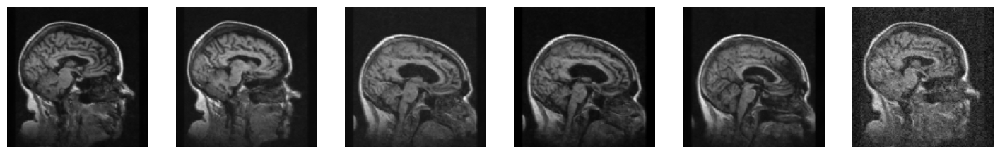

Epoch: 161 | Loss: 0.0100
Epoch: 162 | Loss: 0.0112
Epoch: 163 | Loss: 0.0075
Epoch: 164 | Loss: 0.0091
Epoch: 165 | Loss: 0.0088
Epoch: 166 | Loss: 0.0079
Epoch: 167 | Loss: 0.0058
Epoch: 168 | Loss: 0.0071
Epoch: 169 | Loss: 0.0080
Epoch: 170 | Loss: 0.0084


  0%|          | 0/1000 [00:00<?, ?it/s]

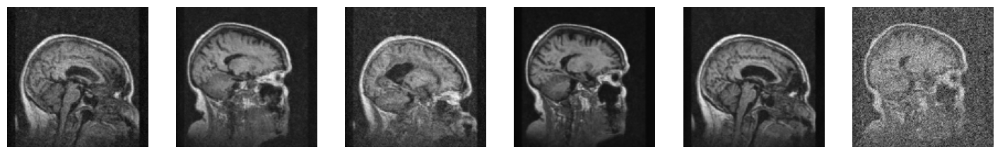

Epoch: 171 | Loss: 0.0098
Epoch: 172 | Loss: 0.0108
Epoch: 173 | Loss: 0.0073
Epoch: 174 | Loss: 0.0085
Epoch: 175 | Loss: 0.0084
Epoch: 176 | Loss: 0.0074
Epoch: 177 | Loss: 0.0056
Epoch: 178 | Loss: 0.0069
Epoch: 179 | Loss: 0.0076
Epoch: 180 | Loss: 0.0079


  0%|          | 0/1000 [00:00<?, ?it/s]

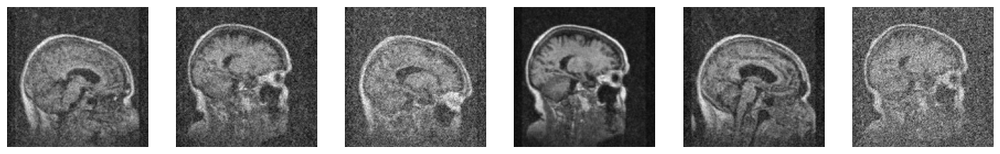

Epoch: 181 | Loss: 0.0092
Epoch: 182 | Loss: 0.0105
Epoch: 183 | Loss: 0.0071
Epoch: 184 | Loss: 0.0081
Epoch: 185 | Loss: 0.0078
Epoch: 186 | Loss: 0.0073
Epoch: 187 | Loss: 0.0052
Epoch: 188 | Loss: 0.0066
Epoch: 189 | Loss: 0.0072
Epoch: 190 | Loss: 0.0074


  0%|          | 0/1000 [00:00<?, ?it/s]

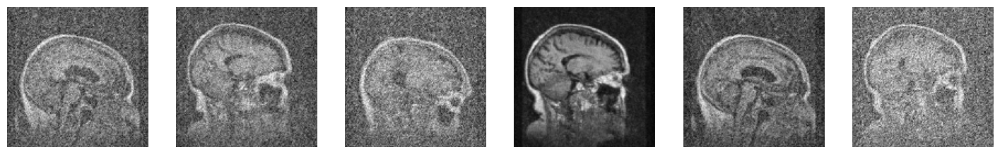

Epoch: 191 | Loss: 0.0086
Epoch: 192 | Loss: 0.0098
Epoch: 193 | Loss: 0.0067
Epoch: 194 | Loss: 0.0076
Epoch: 195 | Loss: 0.0070
Epoch: 196 | Loss: 0.0066
Epoch: 197 | Loss: 0.0050
Epoch: 198 | Loss: 0.0061
Epoch: 199 | Loss: 0.0071
Epoch: 200 | Loss: 0.0069


  0%|          | 0/1000 [00:00<?, ?it/s]

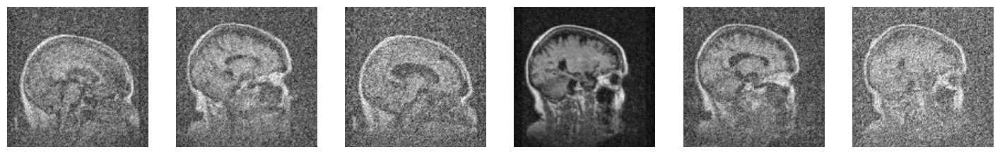

Epoch: 201 | Loss: 0.0084
Epoch: 202 | Loss: 0.0094
Epoch: 203 | Loss: 0.0067
Epoch: 204 | Loss: 0.0072
Epoch: 205 | Loss: 0.0067
Epoch: 206 | Loss: 0.0065
Epoch: 207 | Loss: 0.0049
Epoch: 208 | Loss: 0.0058
Epoch: 209 | Loss: 0.0066
Epoch: 210 | Loss: 0.0066


  0%|          | 0/1000 [00:00<?, ?it/s]

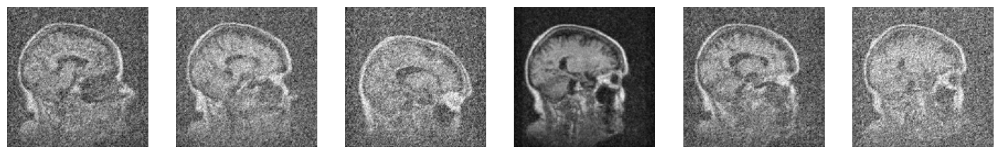

Epoch: 211 | Loss: 0.0079
Epoch: 212 | Loss: 0.0091
Epoch: 213 | Loss: 0.0064
Epoch: 214 | Loss: 0.0069
Epoch: 215 | Loss: 0.0065
Epoch: 216 | Loss: 0.0062
Epoch: 217 | Loss: 0.0049
Epoch: 218 | Loss: 0.0057
Epoch: 219 | Loss: 0.0065
Epoch: 220 | Loss: 0.0065


  0%|          | 0/1000 [00:00<?, ?it/s]

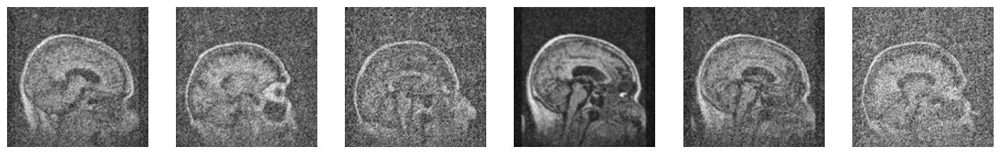

Epoch: 221 | Loss: 0.0078
Epoch: 222 | Loss: 0.0090
Epoch: 223 | Loss: 0.0065
Epoch: 224 | Loss: 0.0071
Epoch: 225 | Loss: 0.0066
Epoch: 226 | Loss: 0.0062
Epoch: 227 | Loss: 0.0048
Epoch: 228 | Loss: 0.0056
Epoch: 229 | Loss: 0.0061
Epoch: 230 | Loss: 0.0061


  0%|          | 0/1000 [00:00<?, ?it/s]

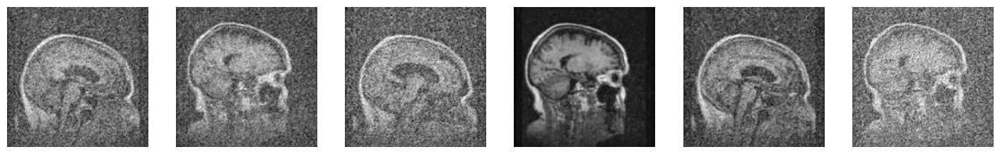

Epoch: 231 | Loss: 0.0074
Epoch: 232 | Loss: 0.0082
Epoch: 233 | Loss: 0.0060
Epoch: 234 | Loss: 0.0063
Epoch: 235 | Loss: 0.0060
Epoch: 236 | Loss: 0.0057
Epoch: 237 | Loss: 0.0043
Epoch: 238 | Loss: 0.0052
Epoch: 239 | Loss: 0.0057
Epoch: 240 | Loss: 0.0057


  0%|          | 0/1000 [00:00<?, ?it/s]

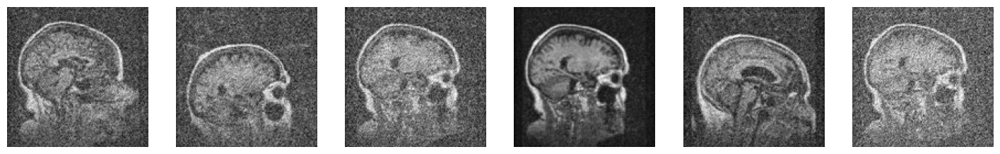

Epoch: 241 | Loss: 0.0067
Epoch: 242 | Loss: 0.0076
Epoch: 243 | Loss: 0.0056
Epoch: 244 | Loss: 0.0059
Epoch: 245 | Loss: 0.0055
Epoch: 246 | Loss: 0.0054
Epoch: 247 | Loss: 0.0040
Epoch: 248 | Loss: 0.0049
Epoch: 249 | Loss: 0.0054
Epoch: 250 | Loss: 0.0055


  0%|          | 0/1000 [00:00<?, ?it/s]

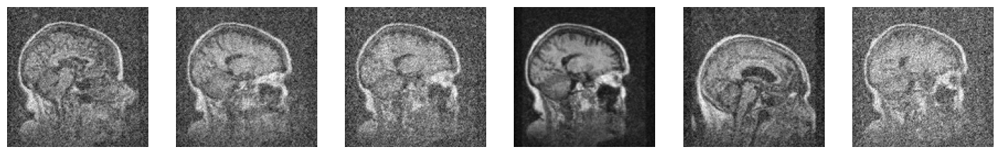

Epoch: 251 | Loss: 0.0062
Epoch: 252 | Loss: 0.0070
Epoch: 253 | Loss: 0.0054
Epoch: 254 | Loss: 0.0057
Epoch: 255 | Loss: 0.0052
Epoch: 256 | Loss: 0.0050
Epoch: 257 | Loss: 0.0039
Epoch: 258 | Loss: 0.0048
Epoch: 259 | Loss: 0.0052
Epoch: 260 | Loss: 0.0052


  0%|          | 0/1000 [00:00<?, ?it/s]

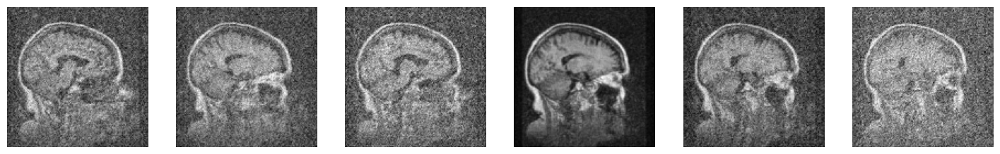

Epoch: 261 | Loss: 0.0062
Epoch: 262 | Loss: 0.0067
Epoch: 263 | Loss: 0.0053
Epoch: 264 | Loss: 0.0055
Epoch: 265 | Loss: 0.0051
Epoch: 266 | Loss: 0.0048
Epoch: 267 | Loss: 0.0037
Epoch: 268 | Loss: 0.0046
Epoch: 269 | Loss: 0.0049
Epoch: 270 | Loss: 0.0048


  0%|          | 0/1000 [00:00<?, ?it/s]

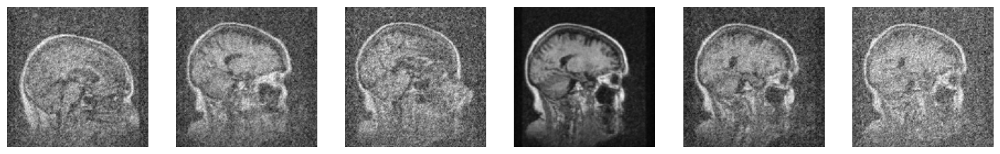

Epoch: 271 | Loss: 0.0056
Epoch: 272 | Loss: 0.0064
Epoch: 273 | Loss: 0.0051
Epoch: 274 | Loss: 0.0054
Epoch: 275 | Loss: 0.0049
Epoch: 276 | Loss: 0.0047
Epoch: 277 | Loss: 0.0037
Epoch: 278 | Loss: 0.0045
Epoch: 279 | Loss: 0.0049
Epoch: 280 | Loss: 0.0047


  0%|          | 0/1000 [00:00<?, ?it/s]

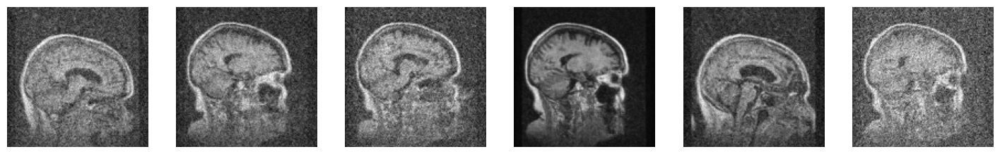

Epoch: 281 | Loss: 0.0055
Epoch: 282 | Loss: 0.0062
Epoch: 283 | Loss: 0.0048
Epoch: 284 | Loss: 0.0051
Epoch: 285 | Loss: 0.0049
Epoch: 286 | Loss: 0.0045
Epoch: 287 | Loss: 0.0035
Epoch: 288 | Loss: 0.0043
Epoch: 289 | Loss: 0.0047
Epoch: 290 | Loss: 0.0046


  0%|          | 0/1000 [00:00<?, ?it/s]

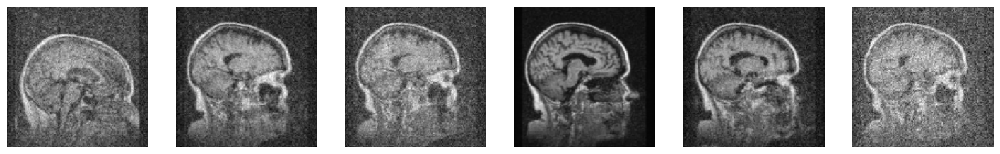

Epoch: 291 | Loss: 0.0055
Epoch: 292 | Loss: 0.0061
Epoch: 293 | Loss: 0.0047
Epoch: 294 | Loss: 0.0047
Epoch: 295 | Loss: 0.0046
Epoch: 296 | Loss: 0.0044
Epoch: 297 | Loss: 0.0035
Epoch: 298 | Loss: 0.0042
Epoch: 299 | Loss: 0.0046
Epoch: 300 | Loss: 0.0043


  0%|          | 0/1000 [00:00<?, ?it/s]

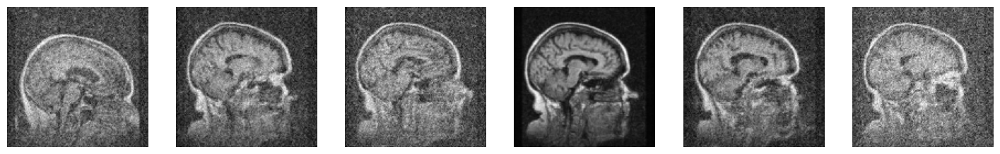

Epoch: 301 | Loss: 0.0052
Epoch: 302 | Loss: 0.0062
Epoch: 303 | Loss: 0.0050
Epoch: 304 | Loss: 0.0048
Epoch: 305 | Loss: 0.0043
Epoch: 306 | Loss: 0.0041
Epoch: 307 | Loss: 0.0034
Epoch: 308 | Loss: 0.0039
Epoch: 309 | Loss: 0.0043
Epoch: 310 | Loss: 0.0041


  0%|          | 0/1000 [00:00<?, ?it/s]

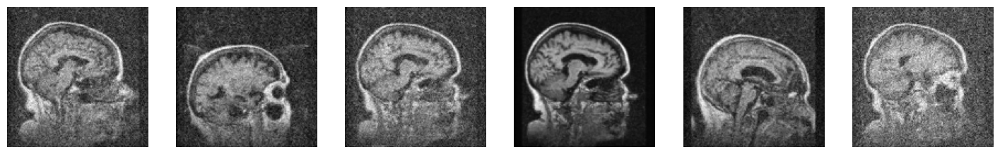

Epoch: 311 | Loss: 0.0047
Epoch: 312 | Loss: 0.0055
Epoch: 313 | Loss: 0.0045
Epoch: 314 | Loss: 0.0046
Epoch: 315 | Loss: 0.0041
Epoch: 316 | Loss: 0.0038
Epoch: 317 | Loss: 0.0031
Epoch: 318 | Loss: 0.0036
Epoch: 319 | Loss: 0.0040
Epoch: 320 | Loss: 0.0039


  0%|          | 0/1000 [00:00<?, ?it/s]

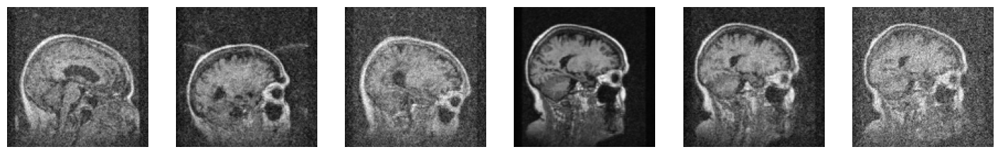

Epoch: 321 | Loss: 0.0042
Epoch: 322 | Loss: 0.0050
Epoch: 323 | Loss: 0.0042
Epoch: 324 | Loss: 0.0044
Epoch: 325 | Loss: 0.0038
Epoch: 326 | Loss: 0.0036
Epoch: 327 | Loss: 0.0028
Epoch: 328 | Loss: 0.0034
Epoch: 329 | Loss: 0.0037
Epoch: 330 | Loss: 0.0037


  0%|          | 0/1000 [00:00<?, ?it/s]

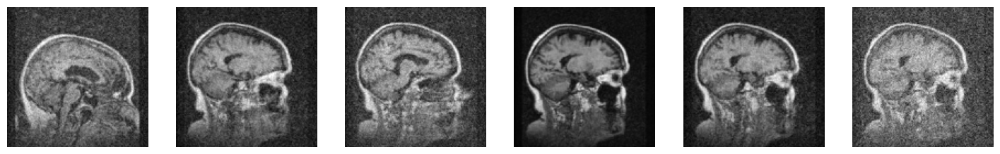

Epoch: 331 | Loss: 0.0043
Epoch: 332 | Loss: 0.0047
Epoch: 333 | Loss: 0.0040
Epoch: 334 | Loss: 0.0042
Epoch: 335 | Loss: 0.0037
Epoch: 336 | Loss: 0.0034
Epoch: 337 | Loss: 0.0027
Epoch: 338 | Loss: 0.0032
Epoch: 339 | Loss: 0.0035
Epoch: 340 | Loss: 0.0036


  0%|          | 0/1000 [00:00<?, ?it/s]

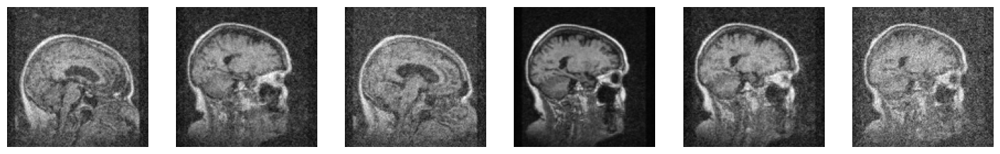

Epoch: 341 | Loss: 0.0041
Epoch: 342 | Loss: 0.0047
Epoch: 343 | Loss: 0.0039
Epoch: 344 | Loss: 0.0040
Epoch: 345 | Loss: 0.0036
Epoch: 346 | Loss: 0.0035
Epoch: 347 | Loss: 0.0027
Epoch: 348 | Loss: 0.0032
Epoch: 349 | Loss: 0.0035
Epoch: 350 | Loss: 0.0034


  0%|          | 0/1000 [00:00<?, ?it/s]

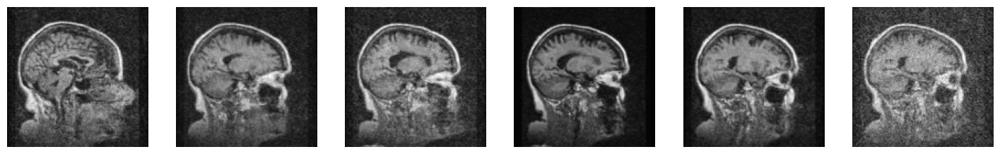

Epoch: 351 | Loss: 0.0040
Epoch: 352 | Loss: 0.0047
Epoch: 353 | Loss: 0.0039
Epoch: 354 | Loss: 0.0040
Epoch: 355 | Loss: 0.0036
Epoch: 356 | Loss: 0.0034
Epoch: 357 | Loss: 0.0026
Epoch: 358 | Loss: 0.0031
Epoch: 359 | Loss: 0.0035
Epoch: 360 | Loss: 0.0034


  0%|          | 0/1000 [00:00<?, ?it/s]

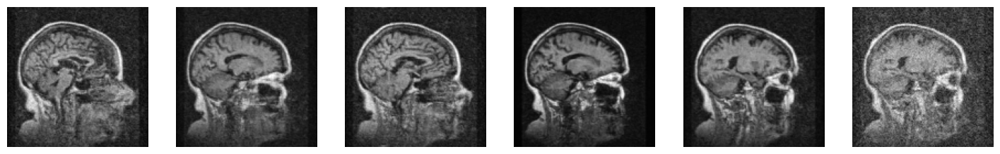

Epoch: 361 | Loss: 0.0040
Epoch: 362 | Loss: 0.0045
Epoch: 363 | Loss: 0.0037
Epoch: 364 | Loss: 0.0040
Epoch: 365 | Loss: 0.0035
Epoch: 366 | Loss: 0.0033
Epoch: 367 | Loss: 0.0026
Epoch: 368 | Loss: 0.0031
Epoch: 369 | Loss: 0.0033
Epoch: 370 | Loss: 0.0033


  0%|          | 0/1000 [00:00<?, ?it/s]

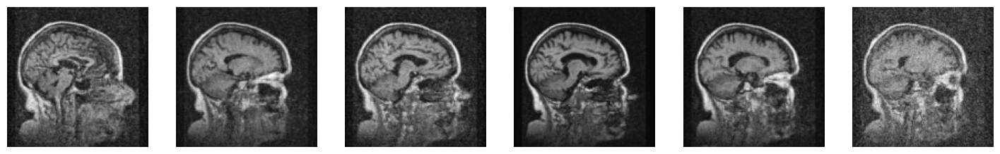

Epoch: 371 | Loss: 0.0039
Epoch: 372 | Loss: 0.0043
Epoch: 373 | Loss: 0.0035
Epoch: 374 | Loss: 0.0039
Epoch: 375 | Loss: 0.0033
Epoch: 376 | Loss: 0.0032
Epoch: 377 | Loss: 0.0025
Epoch: 378 | Loss: 0.0030
Epoch: 379 | Loss: 0.0033
Epoch: 380 | Loss: 0.0031


  0%|          | 0/1000 [00:00<?, ?it/s]

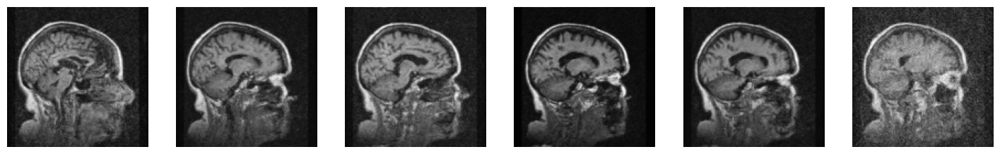

Epoch: 381 | Loss: 0.0036
Epoch: 382 | Loss: 0.0041
Epoch: 383 | Loss: 0.0033
Epoch: 384 | Loss: 0.0036
Epoch: 385 | Loss: 0.0032
Epoch: 386 | Loss: 0.0031
Epoch: 387 | Loss: 0.0024
Epoch: 388 | Loss: 0.0029
Epoch: 389 | Loss: 0.0031
Epoch: 390 | Loss: 0.0030


  0%|          | 0/1000 [00:00<?, ?it/s]

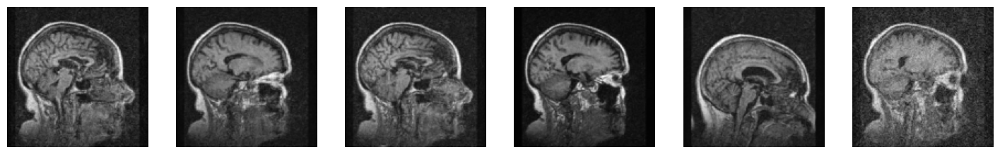

Epoch: 391 | Loss: 0.0035
Epoch: 392 | Loss: 0.0039
Epoch: 393 | Loss: 0.0033
Epoch: 394 | Loss: 0.0034
Epoch: 395 | Loss: 0.0031
Epoch: 396 | Loss: 0.0031
Epoch: 397 | Loss: 0.0023
Epoch: 398 | Loss: 0.0028
Epoch: 399 | Loss: 0.0030
Epoch: 400 | Loss: 0.0028


  0%|          | 0/1000 [00:00<?, ?it/s]

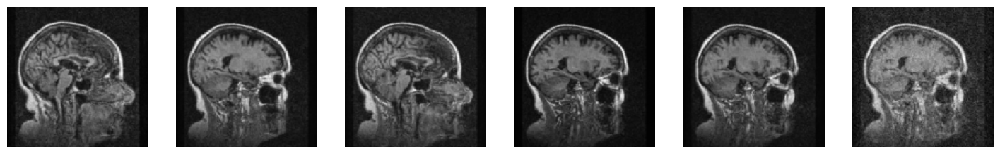

Epoch: 401 | Loss: 0.0033
Epoch: 402 | Loss: 0.0036
Epoch: 403 | Loss: 0.0031
Epoch: 404 | Loss: 0.0033
Epoch: 405 | Loss: 0.0029
Epoch: 406 | Loss: 0.0029
Epoch: 407 | Loss: 0.0023
Epoch: 408 | Loss: 0.0026
Epoch: 409 | Loss: 0.0029
Epoch: 410 | Loss: 0.0028


  0%|          | 0/1000 [00:00<?, ?it/s]

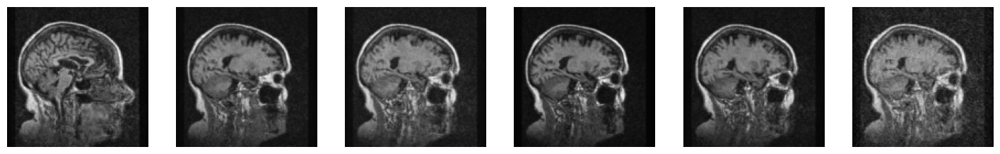

Epoch: 411 | Loss: 0.0031
Epoch: 412 | Loss: 0.0035
Epoch: 413 | Loss: 0.0030
Epoch: 414 | Loss: 0.0030
Epoch: 415 | Loss: 0.0028
Epoch: 416 | Loss: 0.0028
Epoch: 417 | Loss: 0.0022
Epoch: 418 | Loss: 0.0026
Epoch: 419 | Loss: 0.0027
Epoch: 420 | Loss: 0.0027


  0%|          | 0/1000 [00:00<?, ?it/s]

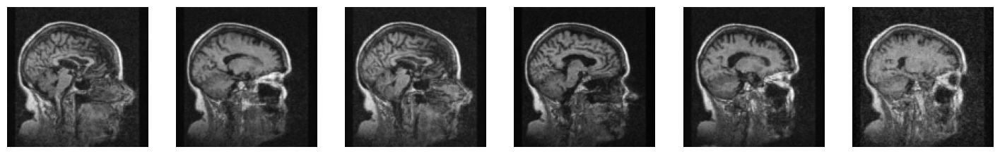

Epoch: 421 | Loss: 0.0029
Epoch: 422 | Loss: 0.0032
Epoch: 423 | Loss: 0.0028
Epoch: 424 | Loss: 0.0028
Epoch: 425 | Loss: 0.0026
Epoch: 426 | Loss: 0.0026
Epoch: 427 | Loss: 0.0021
Epoch: 428 | Loss: 0.0025
Epoch: 429 | Loss: 0.0027
Epoch: 430 | Loss: 0.0026


  0%|          | 0/1000 [00:00<?, ?it/s]

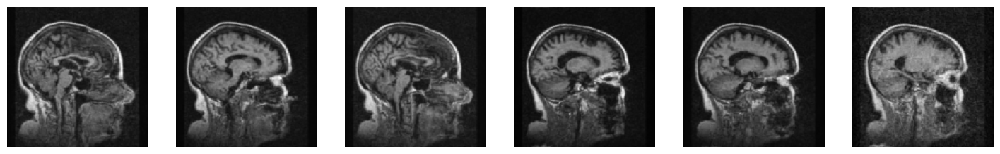

Epoch: 431 | Loss: 0.0029
Epoch: 432 | Loss: 0.0031
Epoch: 433 | Loss: 0.0027
Epoch: 434 | Loss: 0.0028
Epoch: 435 | Loss: 0.0025
Epoch: 436 | Loss: 0.0024
Epoch: 437 | Loss: 0.0020
Epoch: 438 | Loss: 0.0024
Epoch: 439 | Loss: 0.0026
Epoch: 440 | Loss: 0.0025


  0%|          | 0/1000 [00:00<?, ?it/s]

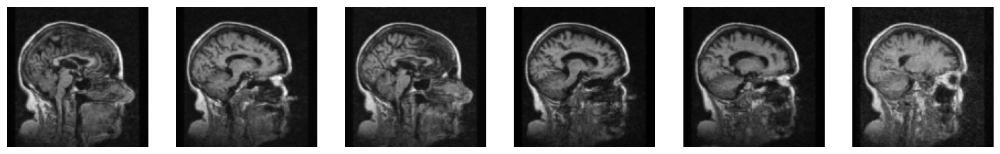

Epoch: 441 | Loss: 0.0028
Epoch: 442 | Loss: 0.0030
Epoch: 443 | Loss: 0.0025
Epoch: 444 | Loss: 0.0026
Epoch: 445 | Loss: 0.0024
Epoch: 446 | Loss: 0.0024
Epoch: 447 | Loss: 0.0019
Epoch: 448 | Loss: 0.0023
Epoch: 449 | Loss: 0.0026
Epoch: 450 | Loss: 0.0024


  0%|          | 0/1000 [00:00<?, ?it/s]

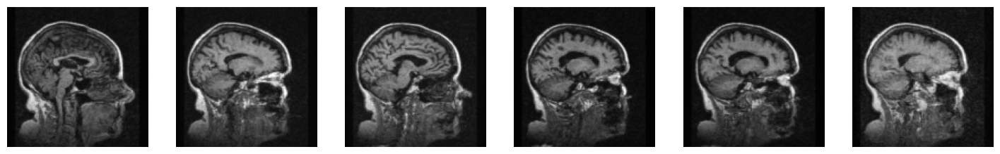

Epoch: 451 | Loss: 0.0027
Epoch: 452 | Loss: 0.0030
Epoch: 453 | Loss: 0.0024
Epoch: 454 | Loss: 0.0025
Epoch: 455 | Loss: 0.0023
Epoch: 456 | Loss: 0.0024
Epoch: 457 | Loss: 0.0018
Epoch: 458 | Loss: 0.0022
Epoch: 459 | Loss: 0.0024
Epoch: 460 | Loss: 0.0024


  0%|          | 0/1000 [00:00<?, ?it/s]

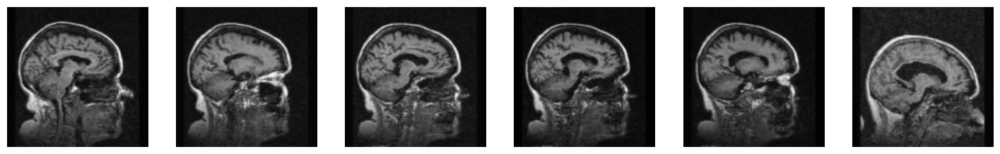

Epoch: 461 | Loss: 0.0026
Epoch: 462 | Loss: 0.0028
Epoch: 463 | Loss: 0.0024
Epoch: 464 | Loss: 0.0024
Epoch: 465 | Loss: 0.0023
Epoch: 466 | Loss: 0.0023
Epoch: 467 | Loss: 0.0018
Epoch: 468 | Loss: 0.0021
Epoch: 469 | Loss: 0.0023
Epoch: 470 | Loss: 0.0025


  0%|          | 0/1000 [00:00<?, ?it/s]

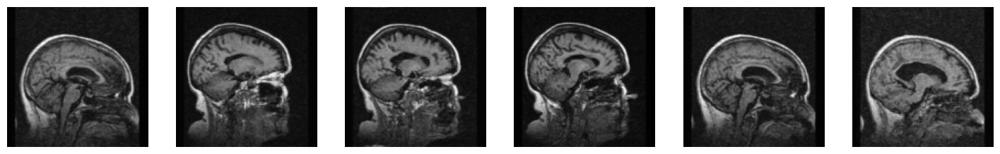

Epoch: 471 | Loss: 0.0026
Epoch: 472 | Loss: 0.0028
Epoch: 473 | Loss: 0.0024
Epoch: 474 | Loss: 0.0023
Epoch: 475 | Loss: 0.0022
Epoch: 476 | Loss: 0.0023
Epoch: 477 | Loss: 0.0018
Epoch: 478 | Loss: 0.0020
Epoch: 479 | Loss: 0.0023
Epoch: 480 | Loss: 0.0024


  0%|          | 0/1000 [00:00<?, ?it/s]

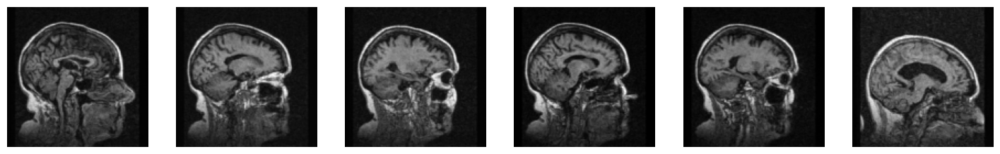

Epoch: 481 | Loss: 0.0025
Epoch: 482 | Loss: 0.0027
Epoch: 483 | Loss: 0.0024
Epoch: 484 | Loss: 0.0023
Epoch: 485 | Loss: 0.0022
Epoch: 486 | Loss: 0.0023
Epoch: 487 | Loss: 0.0017
Epoch: 488 | Loss: 0.0019
Epoch: 489 | Loss: 0.0021
Epoch: 490 | Loss: 0.0023


  0%|          | 0/1000 [00:00<?, ?it/s]

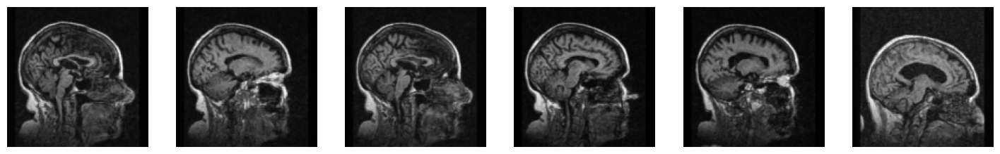

Epoch: 491 | Loss: 0.0026
Epoch: 492 | Loss: 0.0025
Epoch: 493 | Loss: 0.0023
Epoch: 494 | Loss: 0.0022
Epoch: 495 | Loss: 0.0022
Epoch: 496 | Loss: 0.0023
Epoch: 497 | Loss: 0.0018
Epoch: 498 | Loss: 0.0019
Epoch: 499 | Loss: 0.0020
Epoch: 500 | Loss: 0.0022


  0%|          | 0/1000 [00:00<?, ?it/s]

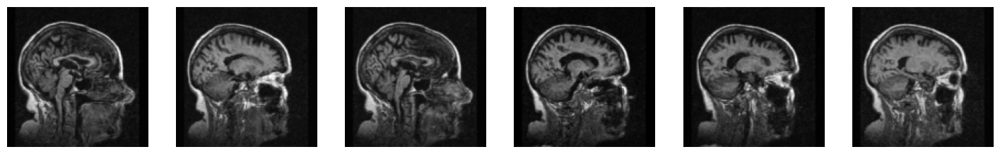

Epoch: 501 | Loss: 0.0025
Epoch: 502 | Loss: 0.0025
Epoch: 503 | Loss: 0.0022
Epoch: 504 | Loss: 0.0022
Epoch: 505 | Loss: 0.0021
Epoch: 506 | Loss: 0.0023
Epoch: 507 | Loss: 0.0017
Epoch: 508 | Loss: 0.0018
Epoch: 509 | Loss: 0.0019
Epoch: 510 | Loss: 0.0020


  0%|          | 0/1000 [00:00<?, ?it/s]

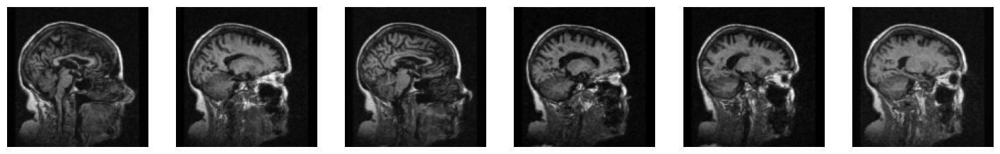

Epoch: 511 | Loss: 0.0023
Epoch: 512 | Loss: 0.0024
Epoch: 513 | Loss: 0.0020
Epoch: 514 | Loss: 0.0021
Epoch: 515 | Loss: 0.0019
Epoch: 516 | Loss: 0.0021
Epoch: 517 | Loss: 0.0017
Epoch: 518 | Loss: 0.0018
Epoch: 519 | Loss: 0.0018
Epoch: 520 | Loss: 0.0019


  0%|          | 0/1000 [00:00<?, ?it/s]

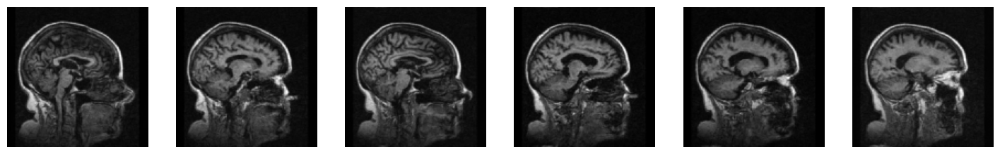

Epoch: 521 | Loss: 0.0021
Epoch: 522 | Loss: 0.0022
Epoch: 523 | Loss: 0.0019
Epoch: 524 | Loss: 0.0020
Epoch: 525 | Loss: 0.0018
Epoch: 526 | Loss: 0.0020
Epoch: 527 | Loss: 0.0016
Epoch: 528 | Loss: 0.0017
Epoch: 529 | Loss: 0.0017
Epoch: 530 | Loss: 0.0018


  0%|          | 0/1000 [00:00<?, ?it/s]

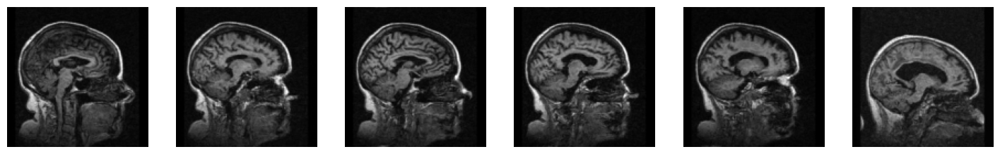

Epoch: 531 | Loss: 0.0020
Epoch: 532 | Loss: 0.0021
Epoch: 533 | Loss: 0.0019
Epoch: 534 | Loss: 0.0019
Epoch: 535 | Loss: 0.0018
Epoch: 536 | Loss: 0.0019
Epoch: 537 | Loss: 0.0015
Epoch: 538 | Loss: 0.0016
Epoch: 539 | Loss: 0.0016
Epoch: 540 | Loss: 0.0017


  0%|          | 0/1000 [00:00<?, ?it/s]

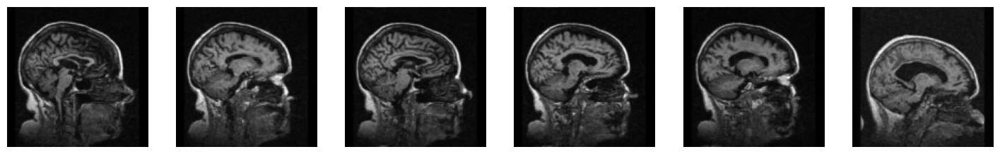

Epoch: 541 | Loss: 0.0019
Epoch: 542 | Loss: 0.0020
Epoch: 543 | Loss: 0.0018
Epoch: 544 | Loss: 0.0018
Epoch: 545 | Loss: 0.0017
Epoch: 546 | Loss: 0.0017
Epoch: 547 | Loss: 0.0014
Epoch: 548 | Loss: 0.0015
Epoch: 549 | Loss: 0.0016
Epoch: 550 | Loss: 0.0016


  0%|          | 0/1000 [00:00<?, ?it/s]

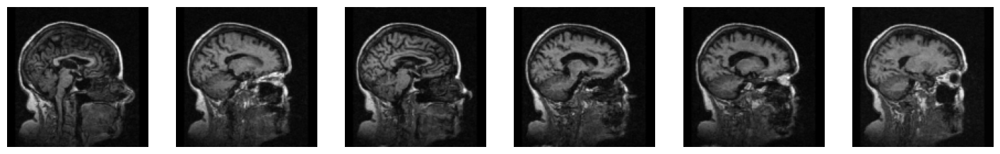

Epoch: 551 | Loss: 0.0017
Epoch: 552 | Loss: 0.0019
Epoch: 553 | Loss: 0.0017
Epoch: 554 | Loss: 0.0018
Epoch: 555 | Loss: 0.0016
Epoch: 556 | Loss: 0.0016
Epoch: 557 | Loss: 0.0013
Epoch: 558 | Loss: 0.0015
Epoch: 559 | Loss: 0.0015
Epoch: 560 | Loss: 0.0015


  0%|          | 0/1000 [00:00<?, ?it/s]

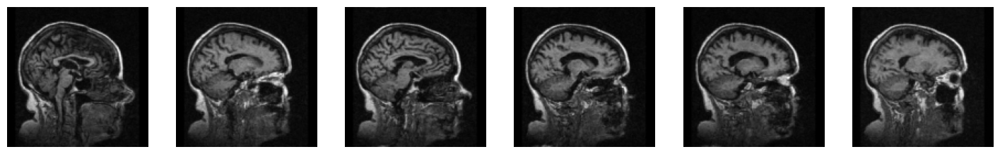

Epoch: 561 | Loss: 0.0017
Epoch: 562 | Loss: 0.0018
Epoch: 563 | Loss: 0.0017
Epoch: 564 | Loss: 0.0017
Epoch: 565 | Loss: 0.0016
Epoch: 566 | Loss: 0.0016
Epoch: 567 | Loss: 0.0013
Epoch: 568 | Loss: 0.0014
Epoch: 569 | Loss: 0.0014
Epoch: 570 | Loss: 0.0014


  0%|          | 0/1000 [00:00<?, ?it/s]

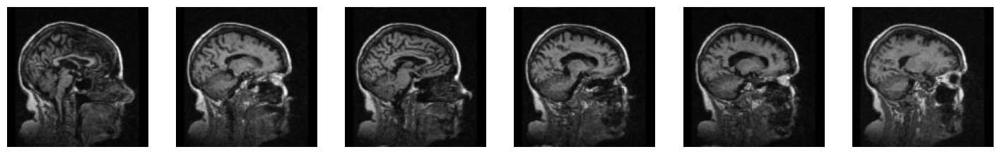

Epoch: 571 | Loss: 0.0016
Epoch: 572 | Loss: 0.0018
Epoch: 573 | Loss: 0.0016
Epoch: 574 | Loss: 0.0016
Epoch: 575 | Loss: 0.0015
Epoch: 576 | Loss: 0.0015
Epoch: 577 | Loss: 0.0012
Epoch: 578 | Loss: 0.0014
Epoch: 579 | Loss: 0.0014
Epoch: 580 | Loss: 0.0014


  0%|          | 0/1000 [00:00<?, ?it/s]

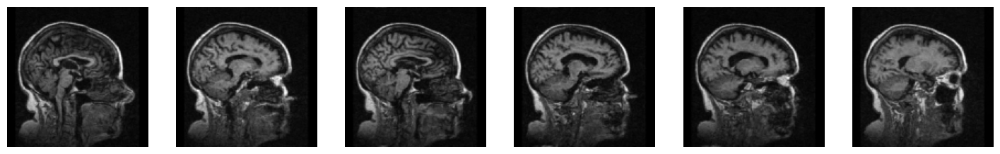

Epoch: 581 | Loss: 0.0016
Epoch: 582 | Loss: 0.0017
Epoch: 583 | Loss: 0.0016
Epoch: 584 | Loss: 0.0016
Epoch: 585 | Loss: 0.0014
Epoch: 586 | Loss: 0.0015
Epoch: 587 | Loss: 0.0012
Epoch: 588 | Loss: 0.0013
Epoch: 589 | Loss: 0.0013
Epoch: 590 | Loss: 0.0014


  0%|          | 0/1000 [00:00<?, ?it/s]

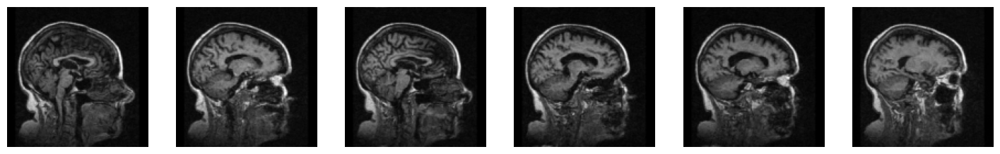

Epoch: 591 | Loss: 0.0015
Epoch: 592 | Loss: 0.0017
Epoch: 593 | Loss: 0.0016
Epoch: 594 | Loss: 0.0015
Epoch: 595 | Loss: 0.0014
Epoch: 596 | Loss: 0.0014
Epoch: 597 | Loss: 0.0012
Epoch: 598 | Loss: 0.0013
Epoch: 599 | Loss: 0.0013
Epoch: 600 | Loss: 0.0013


  0%|          | 0/1000 [00:00<?, ?it/s]

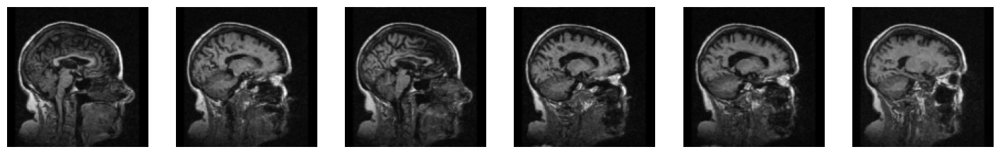

Epoch: 601 | Loss: 0.0015
Epoch: 602 | Loss: 0.0016
Epoch: 603 | Loss: 0.0015
Epoch: 604 | Loss: 0.0015
Epoch: 605 | Loss: 0.0013
Epoch: 606 | Loss: 0.0014
Epoch: 607 | Loss: 0.0011
Epoch: 608 | Loss: 0.0012
Epoch: 609 | Loss: 0.0013
Epoch: 610 | Loss: 0.0013


  0%|          | 0/1000 [00:00<?, ?it/s]

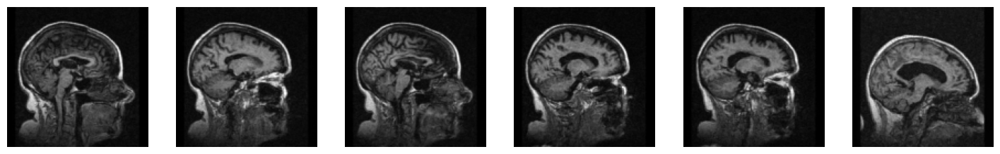

Epoch: 611 | Loss: 0.0014
Epoch: 612 | Loss: 0.0016
Epoch: 613 | Loss: 0.0015
Epoch: 614 | Loss: 0.0014
Epoch: 615 | Loss: 0.0012
Epoch: 616 | Loss: 0.0013
Epoch: 617 | Loss: 0.0011
Epoch: 618 | Loss: 0.0012
Epoch: 619 | Loss: 0.0012
Epoch: 620 | Loss: 0.0012


  0%|          | 0/1000 [00:00<?, ?it/s]

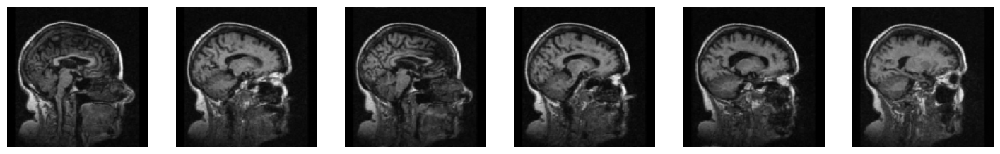

Epoch: 621 | Loss: 0.0013
Epoch: 622 | Loss: 0.0015
Epoch: 623 | Loss: 0.0014
Epoch: 624 | Loss: 0.0013
Epoch: 625 | Loss: 0.0012
Epoch: 626 | Loss: 0.0013
Epoch: 627 | Loss: 0.0011
Epoch: 628 | Loss: 0.0012
Epoch: 629 | Loss: 0.0012
Epoch: 630 | Loss: 0.0012


  0%|          | 0/1000 [00:00<?, ?it/s]

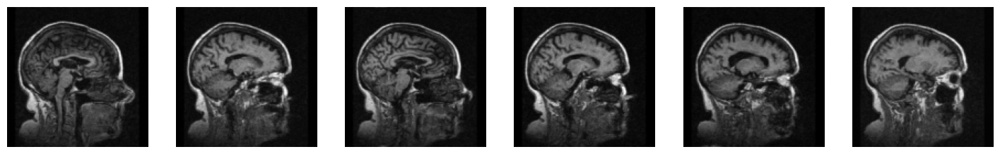

Epoch: 631 | Loss: 0.0013
Epoch: 632 | Loss: 0.0014
Epoch: 633 | Loss: 0.0014
Epoch: 634 | Loss: 0.0013
Epoch: 635 | Loss: 0.0011
Epoch: 636 | Loss: 0.0012
Epoch: 637 | Loss: 0.0010
Epoch: 638 | Loss: 0.0011
Epoch: 639 | Loss: 0.0011
Epoch: 640 | Loss: 0.0011


  0%|          | 0/1000 [00:00<?, ?it/s]

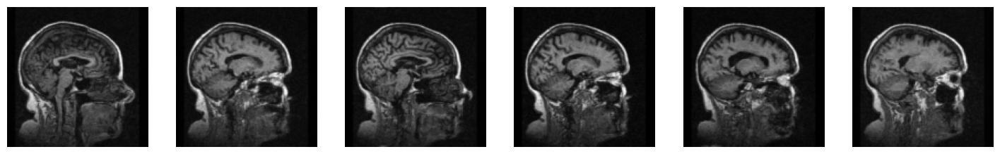

Epoch: 641 | Loss: 0.0012
Epoch: 642 | Loss: 0.0013
Epoch: 643 | Loss: 0.0013
Epoch: 644 | Loss: 0.0013
Epoch: 645 | Loss: 0.0011
Epoch: 646 | Loss: 0.0012
Epoch: 647 | Loss: 0.0010
Epoch: 648 | Loss: 0.0011
Epoch: 649 | Loss: 0.0011
Epoch: 650 | Loss: 0.0011


  0%|          | 0/1000 [00:00<?, ?it/s]

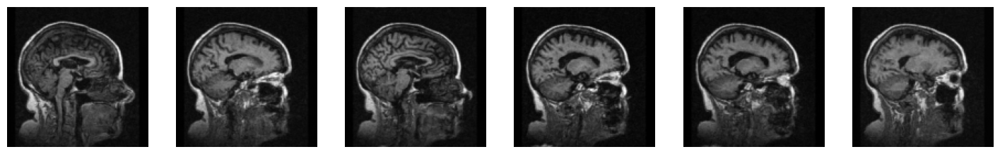

Epoch: 651 | Loss: 0.0012
Epoch: 652 | Loss: 0.0013
Epoch: 653 | Loss: 0.0013
Epoch: 654 | Loss: 0.0013
Epoch: 655 | Loss: 0.0011
Epoch: 656 | Loss: 0.0011
Epoch: 657 | Loss: 0.0010
Epoch: 658 | Loss: 0.0011
Epoch: 659 | Loss: 0.0011
Epoch: 660 | Loss: 0.0011


  0%|          | 0/1000 [00:00<?, ?it/s]

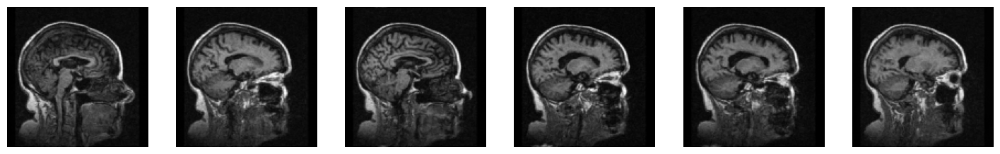

Epoch: 661 | Loss: 0.0012
Epoch: 662 | Loss: 0.0013
Epoch: 663 | Loss: 0.0013
Epoch: 664 | Loss: 0.0012
Epoch: 665 | Loss: 0.0011
Epoch: 666 | Loss: 0.0011
Epoch: 667 | Loss: 0.0010
Epoch: 668 | Loss: 0.0011
Epoch: 669 | Loss: 0.0011
Epoch: 670 | Loss: 0.0011


  0%|          | 0/1000 [00:00<?, ?it/s]

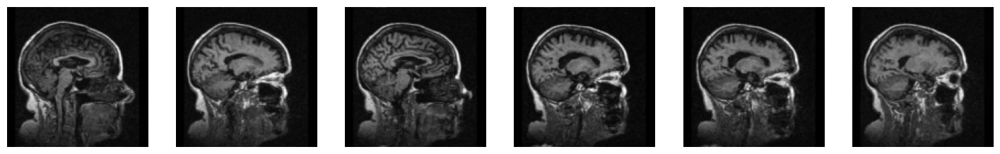

Epoch: 671 | Loss: 0.0012
Epoch: 672 | Loss: 0.0013
Epoch: 673 | Loss: 0.0012
Epoch: 674 | Loss: 0.0012
Epoch: 675 | Loss: 0.0011
Epoch: 676 | Loss: 0.0011
Epoch: 677 | Loss: 0.0010
Epoch: 678 | Loss: 0.0011
Epoch: 679 | Loss: 0.0011
Epoch: 680 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

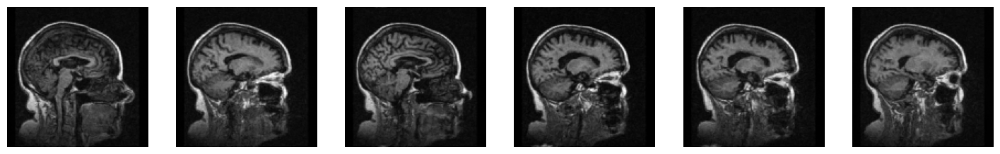

Epoch: 681 | Loss: 0.0011
Epoch: 682 | Loss: 0.0012
Epoch: 683 | Loss: 0.0012
Epoch: 684 | Loss: 0.0012
Epoch: 685 | Loss: 0.0010
Epoch: 686 | Loss: 0.0011
Epoch: 687 | Loss: 0.0009
Epoch: 688 | Loss: 0.0011
Epoch: 689 | Loss: 0.0010
Epoch: 690 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

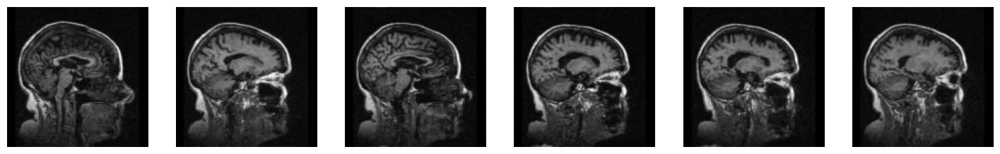

Epoch: 691 | Loss: 0.0011
Epoch: 692 | Loss: 0.0012
Epoch: 693 | Loss: 0.0012
Epoch: 694 | Loss: 0.0012
Epoch: 695 | Loss: 0.0010
Epoch: 696 | Loss: 0.0011
Epoch: 697 | Loss: 0.0009
Epoch: 698 | Loss: 0.0010
Epoch: 699 | Loss: 0.0010
Epoch: 700 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

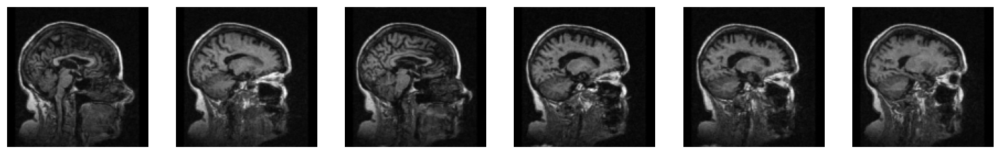

Epoch: 701 | Loss: 0.0011
Epoch: 702 | Loss: 0.0012
Epoch: 703 | Loss: 0.0012
Epoch: 704 | Loss: 0.0012
Epoch: 705 | Loss: 0.0010
Epoch: 706 | Loss: 0.0011
Epoch: 707 | Loss: 0.0009
Epoch: 708 | Loss: 0.0010
Epoch: 709 | Loss: 0.0010
Epoch: 710 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

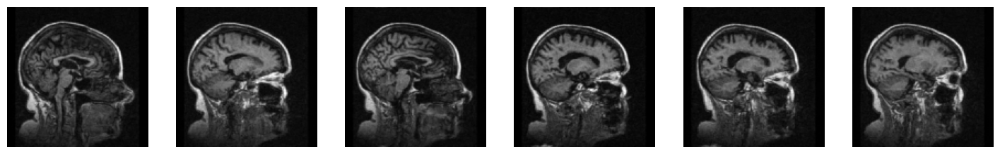

Epoch: 711 | Loss: 0.0011
Epoch: 712 | Loss: 0.0012
Epoch: 713 | Loss: 0.0012
Epoch: 714 | Loss: 0.0011
Epoch: 715 | Loss: 0.0010
Epoch: 716 | Loss: 0.0011
Epoch: 717 | Loss: 0.0009
Epoch: 718 | Loss: 0.0010
Epoch: 719 | Loss: 0.0010
Epoch: 720 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

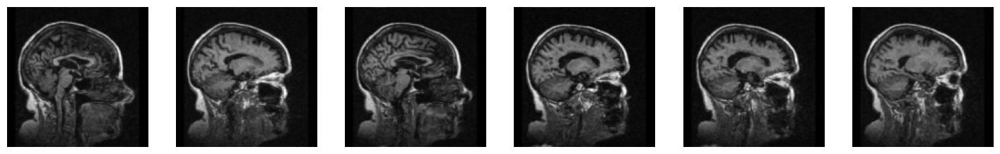

Epoch: 721 | Loss: 0.0011
Epoch: 722 | Loss: 0.0012
Epoch: 723 | Loss: 0.0012
Epoch: 724 | Loss: 0.0011
Epoch: 725 | Loss: 0.0010
Epoch: 726 | Loss: 0.0011
Epoch: 727 | Loss: 0.0009
Epoch: 728 | Loss: 0.0010
Epoch: 729 | Loss: 0.0010
Epoch: 730 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

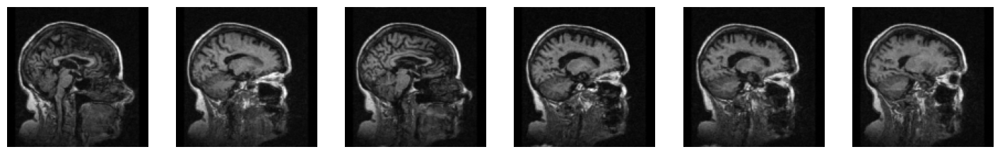

Epoch: 731 | Loss: 0.0011
Epoch: 732 | Loss: 0.0012
Epoch: 733 | Loss: 0.0012
Epoch: 734 | Loss: 0.0011
Epoch: 735 | Loss: 0.0010
Epoch: 736 | Loss: 0.0011
Epoch: 737 | Loss: 0.0009
Epoch: 738 | Loss: 0.0010
Epoch: 739 | Loss: 0.0010
Epoch: 740 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

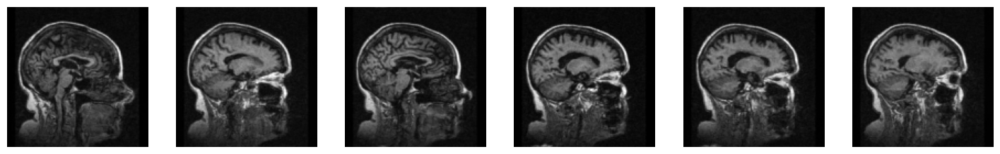

Epoch: 741 | Loss: 0.0011
Epoch: 742 | Loss: 0.0012
Epoch: 743 | Loss: 0.0012
Epoch: 744 | Loss: 0.0012
Epoch: 745 | Loss: 0.0010
Epoch: 746 | Loss: 0.0011
Epoch: 747 | Loss: 0.0009
Epoch: 748 | Loss: 0.0010
Epoch: 749 | Loss: 0.0010
Epoch: 750 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

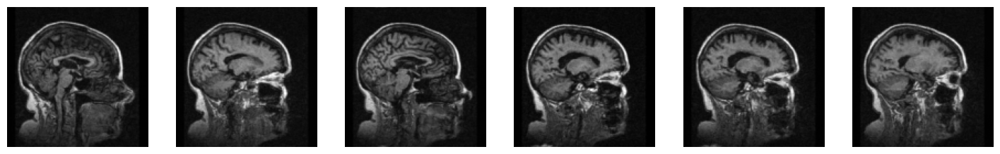

Epoch: 751 | Loss: 0.0011
Epoch: 752 | Loss: 0.0012
Epoch: 753 | Loss: 0.0012
Epoch: 754 | Loss: 0.0012
Epoch: 755 | Loss: 0.0010
Epoch: 756 | Loss: 0.0011
Epoch: 757 | Loss: 0.0009
Epoch: 758 | Loss: 0.0010
Epoch: 759 | Loss: 0.0010
Epoch: 760 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

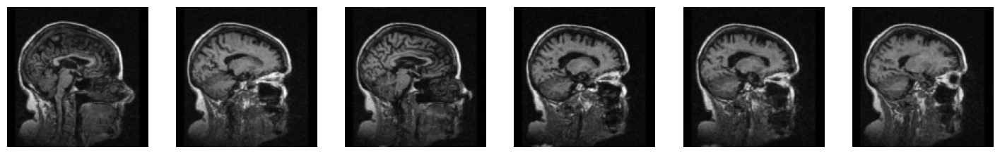

Epoch: 761 | Loss: 0.0011
Epoch: 762 | Loss: 0.0013
Epoch: 763 | Loss: 0.0012
Epoch: 764 | Loss: 0.0012
Epoch: 765 | Loss: 0.0010
Epoch: 766 | Loss: 0.0011
Epoch: 767 | Loss: 0.0009
Epoch: 768 | Loss: 0.0011
Epoch: 769 | Loss: 0.0011
Epoch: 770 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

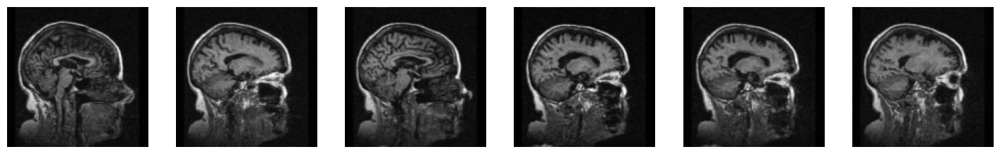

Epoch: 771 | Loss: 0.0011
Epoch: 772 | Loss: 0.0013
Epoch: 773 | Loss: 0.0012
Epoch: 774 | Loss: 0.0012
Epoch: 775 | Loss: 0.0010
Epoch: 776 | Loss: 0.0011
Epoch: 777 | Loss: 0.0009
Epoch: 778 | Loss: 0.0011
Epoch: 779 | Loss: 0.0011
Epoch: 780 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

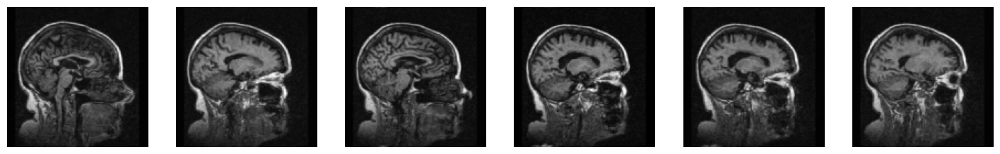

Epoch: 781 | Loss: 0.0011
Epoch: 782 | Loss: 0.0012
Epoch: 783 | Loss: 0.0012
Epoch: 784 | Loss: 0.0012
Epoch: 785 | Loss: 0.0010
Epoch: 786 | Loss: 0.0011
Epoch: 787 | Loss: 0.0009
Epoch: 788 | Loss: 0.0011
Epoch: 789 | Loss: 0.0011
Epoch: 790 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

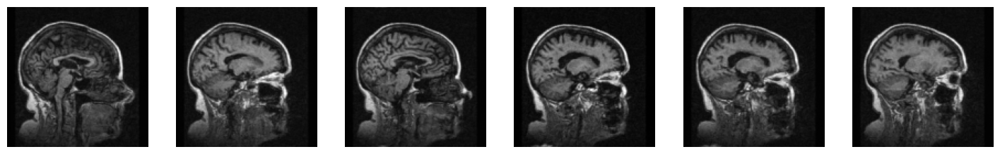

Epoch: 791 | Loss: 0.0011
Epoch: 792 | Loss: 0.0012
Epoch: 793 | Loss: 0.0012
Epoch: 794 | Loss: 0.0012
Epoch: 795 | Loss: 0.0010
Epoch: 796 | Loss: 0.0011
Epoch: 797 | Loss: 0.0009
Epoch: 798 | Loss: 0.0010
Epoch: 799 | Loss: 0.0011
Epoch: 800 | Loss: 0.0010


  0%|          | 0/1000 [00:00<?, ?it/s]

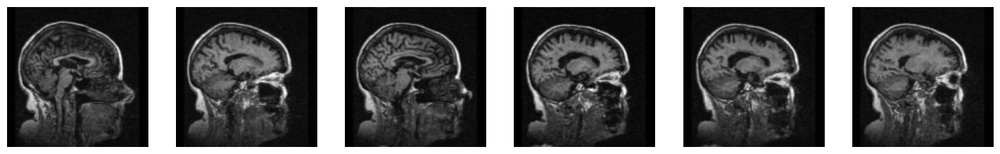

In [13]:
log_path = '/kaggle/working/log'
csv_file_path = os.path.join(log_path, 'training_log.csv')

if not os.path.exists(log_path):
    os.makedirs(log_path)

# Check if the CSV file already exists; if not, write the header
if not os.path.exists(csv_file_path):
    with open(csv_file_path, mode='w', newline='') as f:
        writer = csv.writer(f)
        writer.writerow(['Epoch', 'Loss', 'Learning Rate'])  

# Start training
start = timeit.default_timer()  # Total training start time

for epoch in range(NUM_EPOCHS):
    model.train()
    train_running_loss = 0
    
    for idx, batch in enumerate(train_dataloader):
        clean_images = batch["images"].to(device)
        noise = torch.randn(clean_images.shape).to(device)
        last_batch_size = len(clean_images)
        
        # Generate random timesteps and add noise to the images
        timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (last_batch_size,)).to(device)
        noisy_images = noise_scheduler.add_noise(clean_images, noise, timesteps)
        
        # Accumulate gradients and perform backward pass
        with accelerator.accumulate(model):
            noise_pred = model(noisy_images, timesteps, return_dict=False)[0]
            loss = F.mse_loss(noise_pred, noise)
            accelerator.backward(loss)
            
            accelerator.clip_grad_norm_(model.parameters(), 1.0)  # Clip gradients to avoid explosion
            optimizer.step()       # Perform optimization step
            lr_scheduler.step()    # Update learning rate
            optimizer.zero_grad()  # Zero gradients for next step
            
        train_running_loss += loss.item()
    
    # Average training loss for the epoch
    train_loss = train_running_loss / (idx + 1)
    
    # Log training loss and learning rate
    train_learning_rate = lr_scheduler.get_last_lr()[0]
    print(f"Epoch: {epoch + 1} | Loss: {train_loss:.4f}")

    # Log epoch loss and learning rate to CSV
    with open(csv_file_path, mode='a', newline='') as f:
        writer = csv.writer(f)
        writer.writerow([epoch + 1, train_loss, train_learning_rate]) 

    # Create a subdirectory for every LOG_INTERVAL epochs and save images
    if (epoch + 1) % LOG_INTERVAL == 0:
        epoch_dir = os.path.join(log_path, f'Epoch_{epoch + 1}')
        os.makedirs(epoch_dir, exist_ok=True)
        
        # Generate and save sample images
        generate(model, noise_scheduler, NUM_GENERATE_IMAGES, RANDOM_SEED, NUM_TIMESTEPS, epoch_dir)

    # Save the model only on the last epoch
    if epoch + 1 == NUM_EPOCHS:
        checkpoint = {
            'model_state_dict': model.state_dict(),
            'noise_scheduler': noise_scheduler,
            'optimizer_state_dict': optimizer.state_dict(),
            'lr_scheduler_state_dict': lr_scheduler.state_dict()
        }
        torch.save(checkpoint, os.path.join(log_path, 'oasis-2_sagittal_gen_model.pt'))

stop = timeit.default_timer()  

In [14]:
# Calculate total time in seconds
total_seconds = stop - start

# Convert seconds to hours, minutes, and seconds
hours = total_seconds // 3600
minutes = (total_seconds % 3600) // 60
seconds = total_seconds % 60

# Print the formatted time
print(f"Total Training Time: {int(hours)}h {int(minutes)}m {seconds:.2f}s")

Total Training Time: 6h 53m 27.40s


In [15]:
log = "/kaggle/working/log"
shutil.make_archive(log, 'zip', log)

'/kaggle/working/log.zip'

## **Model Loading**

In [16]:
# Load model checkpoint
checkpoint_path = "/kaggle/working/log/oasis-2_sagittal_gen_model.pt"
checkpoint = torch.load(checkpoint_path, weights_only=False)

# Load model state and noise scheduler
model.load_state_dict(checkpoint['model_state_dict'])
noise_scheduler = checkpoint['noise_scheduler']

# Initialize the pipeline
pipeline = DDPMPipeline(unet=accelerator.unwrap_model(model), scheduler=noise_scheduler)
pipeline.set_progress_bar_config(disable=True)

## **Generate Images**

In [17]:
output_path = "/kaggle/working/synthetic/views/sagittal/moderate_dementia"

if not os.path.exists(output_path):
    os.makedirs(output_path)

In [18]:
REQUIRED_IMAGES = 325
RANDOM_SEED = 42  
NUM_TIMESTEPS = 25 
BATCH_SIZE = 16
NUM_BATCHES = REQUIRED_IMAGES // BATCH_SIZE

start = timeit.default_timer()

generated_images = []

for batch_idx in tqdm(range(NUM_BATCHES), desc="Generating images", ncols=100):
    batch_seed = RANDOM_SEED + batch_idx
    
    batch_images = pipeline(
        batch_size=BATCH_SIZE,
        generator=torch.manual_seed(batch_seed),
        num_inference_steps=NUM_TIMESTEPS
    ).images
    
    generated_images.extend(batch_images)

stop = timeit.default_timer()

total_seconds = stop - start
hours = total_seconds // 3600 
minutes = (total_seconds % 3600) // 60  
seconds = total_seconds % 60  

print(f"Total Generation Time: {int(hours)}h {int(minutes)}m {seconds:.2f}s")

for i in tqdm(range(len(generated_images)), desc="Saving images", ncols=100):
    image_name = f"sagittal_synthetic_{i + 1}.png"  
    image_path = os.path.join(output_path, image_name)
    generated_images[i].save(image_path)

Generating images: 100%|████████████████████████████████████████████| 20/20 [01:48<00:00,  5.42s/it]


Total Generation Time: 0h 1m 48.34s


Saving images: 100%|█████████████████████████████████████████████| 320/320 [00:00<00:00, 645.24it/s]


In [19]:
images = "/kaggle/working/synthetic"
shutil.make_archive(images, 'zip', images)

'/kaggle/working/synthetic.zip'